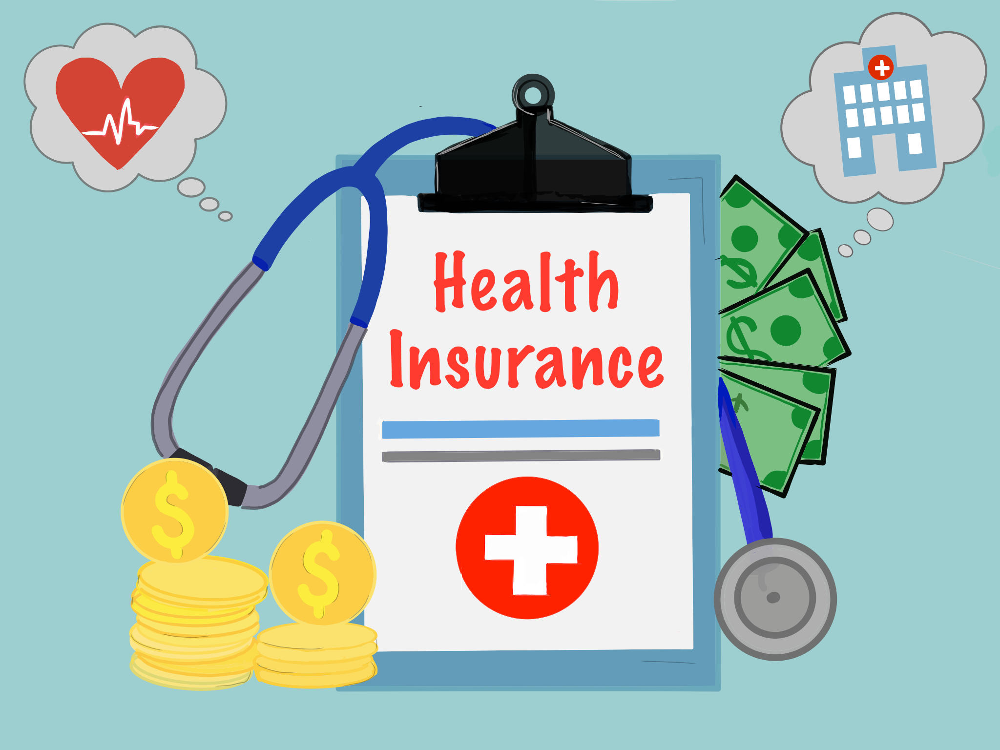

>>>>#  HEALTH INSURANCE MARKETPLACE
>>>>>#  PYTHON GROUP PROJECT
>>>># INFO8065-22W-Sec1-Data Analytics
>>>># Conestoga College, Doon, Kitchener
>>>>## Prepared by - Amritjot Kaur & Sajid Poswal


### Date : April 8,2022
### Instructor : Ahsan Umar

###  1- INTRODUCTION TO DATASETS :-
#### The data used in this project is taken from kaggle.com. It was originally prepared and released by the Centers for Medicare & Medicaid Services (CMS). The goal of this project is to get familiar with the Python basic functions and to get an exposure to a full life cycle of a data project. This data contains following datasets:
* BenefitsCostSharing - Plan variant-level data on essential health benefits, coverage limits, and cost sharing.
* BusinessRules - Plan-level data on rating business rules, such as maximum age for a dependent, and allowed dependent relationships.
* Network - Issuer-level data identifying provider network URLs.
* PlanAttributes - Plan-level data on maximum out of pocket payments, deductibles, HSA eligibility, formulary ID, and other plan attributes.
* Rate - Plan-level data on rates based on an eligible subscriber’s age, tobacco use, and geographic location; and family-tier rates.
* ServiceArea - Issuer-level data on geographic service areas including state, county, and zip code.

#### Importing all the necessary packages required in analysis:
Data analysis frequently necessitates modifications that are beyond the scope of Python's built-in capabilities. As a result, these external libraries/packages must be imported. Importing the essential libraries early in the process is common procedure (usually first two cells)

In [45]:
## Data Analysis Packages
import numpy as np
import pandas as pd

## Data Visualization Packages
import seaborn as sns
import altair as alt
import matplotlib.pyplot as plt

### 2- IMPORTING AND CLEANING REQUIRED FILES :-
#### Sources - 
* Files Source - https://www.kaggle.com/datasets/hhs/health-insurance-marketplace
* Data Description - https://www.cms.gov/cciio/resources/data-resources/marketplace-puf


In [46]:
Benefits = pd.read_csv(r'D:\Data Analytics Assignment\data-society-health-insurance-marketplace\BenefitsCostSharing.csv',
                       na_values = 'None', low_memory = 'False')
BusinessRules = pd.read_csv(r'D:\Data Analytics Assignment\data-society-health-insurance-marketplace\BusinessRules.csv',
                       na_values = 'None', low_memory = 'False')
Network = pd.read_csv(r'D:\Data Analytics Assignment\data-society-health-insurance-marketplace\Network.csv',
                       na_values = 'None', low_memory = 'False')
PlanAttributes = pd.read_csv(r'D:\Data Analytics Assignment\data-society-health-insurance-marketplace\PlanAttributes.csv',
                       na_values = 'None', low_memory = 'False')
ServiceArea = pd.read_csv(r'D:\Data Analytics Assignment\data-society-health-insurance-marketplace\ServiceArea.csv',
                       na_values = 'None', low_memory = 'False')
Rate = pd.read_csv(r'D:\Data Analytics Assignment\data-society-health-insurance-marketplace\Rate.csv',
                       na_values = 'None', low_memory = 'False')

C:\Users\Amritjot Kaur\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3444: DtypeWarning: Columns (3,6) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)
C:\Users\Amritjot Kaur\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3444: DtypeWarning: Columns (0,7,8,9,10,11,12,13,14,15,18,19,20,22,23,24,25,26,27,28,29,31,32,33,34,39,40,41,42,66,67,68,70,71,72,75,76,77,79,80,81,82,84,85,86,88,89,90,92,93,94,96,97,98,136,137,138,140,141,142,145,146,147,150,151,152,154,155,156,158,159,160,162,163,164,166,167,168) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


####  a) Cleaning data after importing the required files:
* Removing empty/unwanted columns
* Removing unwanted white spaces
* Filling empty cells
* Removing Duplicate rows 
* Cleaning the column names from any leading or trailing white spaces
* Dropping columns with Highly Missing Values

In [47]:
## Removing empty/unwanted columns
## Dropping columns with Highly Missing Values

Benefits = Benefits.drop("CoinsInnTier2", axis = 1) 
Benefits = Benefits.drop("CopayInnTier2", axis = 1) 
Rate = Rate.drop("IndividualTobaccoRate", axis = 1)
Rate = Rate.drop("Couple", axis = 1)
Rate = Rate.drop("PrimarySubscriberAndOneDependent", axis = 1)
Rate = Rate.drop("PrimarySubscriberAndTwoDependents", axis = 1)
Rate = Rate.drop("PrimarySubscriberAndThreeOrMoreDependents", axis = 1)
Rate = Rate.drop("CoupleAndOneDependent", axis = 1)
Rate = Rate.drop("CoupleAndTwoDependents", axis = 1)
Rate = Rate.drop("CoupleAndThreeOrMoreDependents", axis = 1)

## Dropping Duplicate rows by concatenating two columns to make a unique id.

Benefits['IssuerRow'] = Benefits['IssuerId'].astype(str) + '-' + Benefits['RowNumber'].astype(str)
Rate['IssuerRow'] = Rate['IssuerId'].astype(str) + '-' + Rate['RowNumber'].astype(str)

Benefits = Benefits.drop_duplicates(subset = 'IssuerRow')
Rate = Rate.drop_duplicates(subset = 'IssuerRow')
 
##Cleaning the column names from any leading or trailing white spaces

Benefits.columns = Benefits.columns.str.strip()
Rate.columns = Rate.columns.str.strip()

#### b) Merging two datasets together, using Pandas Merge Function:
Shape of "Benefits" and "Rates" data sets.

In [48]:
Benefits.shape

(15914, 29)

In [49]:
Rate.shape

(559840, 17)

In [50]:
Rates_wBenefits = pd.merge(Benefits, Rate, on = 'IssuerRow')

#### c) Proportion of null values in the combined dataset:

In [51]:
Rates_wBenefits.isnull().sum()/Rates_wBenefits.shape[0]


BenefitName            0.000000
BusinessYear_x         0.000000
CoinsInnTier1          0.235380
CoinsOutofNet          0.235380
CopayInnTier1          0.235380
CopayOutofNet          0.235380
EHBVarReason           0.575009
Exclusions             0.945877
Explanation            0.819106
ImportDate_x           0.000000
IsCovered              0.093353
IsEHB                  0.474755
IsExclFromInnMOOP      0.220487
IsExclFromOonMOOP      0.219034
IsStateMandate         0.873229
IsSubjToDedTier1       0.218307
IsSubjToDedTier2       0.218307
IssuerId_x             0.000000
LimitQty               0.832910
LimitUnit              0.832910
MinimumStay            0.997821
PlanId_x               0.000000
QuantLimitOnSvc        0.585180
RowNumber_x            0.000000
SourceName_x           0.000000
StandardComponentId    0.000000
StateCode_x            0.000000
VersionNum_x           0.000000
IssuerRow              0.000000
BusinessYear_y         0.000000
StateCode_y            0.000000
IssuerId

### 3- ANALYSIS :-

#### a) What is the state-wise proportion of benefits.

In [52]:
Benefits.groupby('StateCode')['BenefitName'].value_counts(normalize = True)

StateCode  BenefitName                                
AK         Accidental Dental                              0.039604
           Basic Dental Care - Adult                      0.039604
           Basic Dental Care - Child                      0.039604
           Dental Check-Up for Children                   0.039604
           Major Dental Care - Adult                      0.039604
                                                            ...   
WY         Non-Medically Necessary Orthodontia - Child    0.005208
           Prescription and OTC drugs other               0.005208
           Second Surgical Opinion                        0.005208
           Sigmoidoscopy                                  0.005208
           Volontary Sterilization                        0.005208
Name: BenefitName, Length: 3049, dtype: float64

#### b) What kind of benefits are being offered in health insurance marketplace? How many benefits are there in total?
For capturing the different kind of benefits unique() method is used, whereas nunique() is used to get the count of unique benefits that are being offered.

In [53]:
Benefits['BenefitName'].unique()

array(['Routine Dental Services (Adult)', 'Dental Check-Up for Children',
       'Basic Dental Care - Child', 'Orthodontia - Child',
       'Major Dental Care - Child', 'Basic Dental Care - Adult',
       'Orthodontia - Adult', 'Major Dental Care - Adult',
       'Accidental Dental', 'Non-Medically Necessary Orthodontia',
       'Inpatient Hospital Services (e.g., Hospital Stay)',
       'Inpatient Physician and Surgical Services', 'Bariatric Surgery',
       'Cosmetic Surgery', 'Skilled Nursing Facility',
       'Prenatal and Postnatal Care',
       'Delivery and All Inpatient Services for Maternity Care',
       'Mental/Behavioral Health Outpatient Services',
       'Mental/Behavioral Health Inpatient Services',
       'Substance Abuse Disorder Outpatient Services',
       'Non-Medically Necessary Orthodontia - Child',
       'Primary Care Visit to Treat an Injury or Illness',
       'Specialist Visit',
       'Other Practitioner Office Visit (Nurse, Physician Assistant)',
       'Ou

In [54]:
Benefits['BenefitName'].nunique()

358

#### c) Count the number of issuers paying more than 1000 for a particular benefit, on the basis of their tobacco preferences?
For this the merged dataset of benefits and rates will be used, to capture the desired results.

In [55]:
Rates_wBenefits[Rates_wBenefits['IndividualRate']>1000].groupby(['BenefitName'])['Tobacco'].value_counts()

BenefitName                                      Tobacco                      
Abortion for Which Public Funding is Prohibited  No Preference                    1
Accidental Dental                                No Preference                    8
Acupuncture                                      No Preference                    3
                                                 Tobacco User/Non-Tobacco User    1
Allergy Testing                                  No Preference                    1
                                                                                 ..
Urgent Care Centers or Facilities                No Preference                    1
Weight Loss Programs                             No Preference                    3
                                                 Tobacco User/Non-Tobacco User    3
Well Baby Visits and Care                        No Preference                    1
X-rays and Diagnostic Imaging                    No Preference                   

#### d) How may issuers do not prefer tobacco at the age of 65 or over?

In [56]:
Rates_wBenefits[(Rates_wBenefits['Tobacco'] == 'No Preference') & (Rates_wBenefits['Age'] == '65 and over')].shape

(8, 45)

#### e) Display the number of Dependent Maximum Age in a bar graph, with binwidth of 100, using BusinessRules dataset.


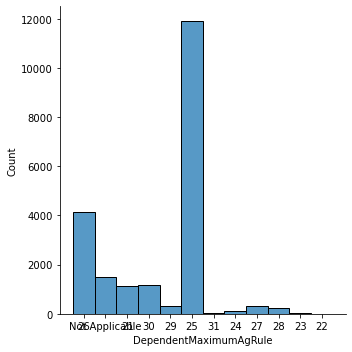

In [14]:
sns.displot(data = BusinessRules, x = "DependentMaximumAgRule", binwidth = 100)

#### f) Count the number of state-wise Networks issued using seaborn package.

<AxesSubplot:xlabel='StateCode', ylabel='count'>

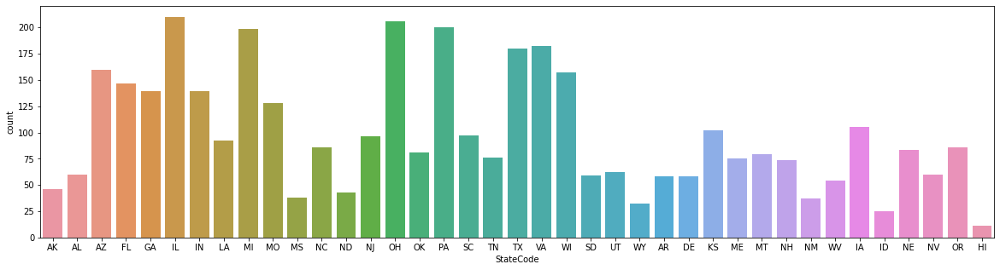

In [32]:
fig, ax = plt.subplots(figsize=(20,5))
sns.countplot(data = Network, x = 'StateCode')
#using altair package
#alt.Chart(Network).mark_bar().encode(x = 'StateCode', y = 'count(NetworkId)')  


#### g) Visualise the number of Service Areas having Coverage of entire state.
This can be achieved by using altair package on "coverentirestate" and "serviceareaname" columns of the ServiceArea Dataset.

In [37]:
#for data greater than 5000 rows, in Altair
alt.data_transformers.disable_max_rows()
alt.Chart(ServiceArea).mark_bar().encode(x = 'CoverEntireState', y = 'count(ServiceAreaName)', color = "DentalOnlyPlan")

alt.Chart(...)

#### h) What proportion of Issuer Ids comes under Service Area 1?

In [17]:
ServiceArea.loc[ServiceArea['ServiceAreaName'] == 'Service Area 1','IssuerId'].value_counts(normalize=True)

63790    0.125267
50022    0.119573
35700    0.102491
26380    0.094662
29416    0.081139
           ...   
77352    0.000712
30884    0.000712
12538    0.000712
74819    0.000712
30042    0.000712
Name: IssuerId, Length: 81, dtype: float64

#### g) Heatmap showing the CSR variations in Issuers.

<AxesSubplot:ylabel='CSRVariationType'>

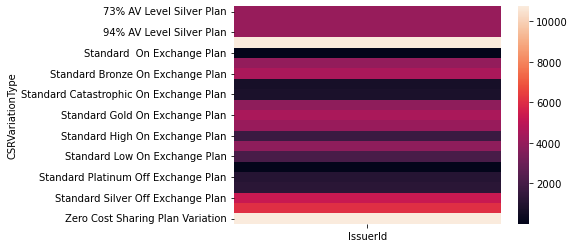

In [44]:
Data_Pivot = PlanAttributes.pivot_table(index = 'CSRVariationType', values = 'IssuerId', aggfunc = 'count')
sns.heatmap(Data_Pivot)